# Using 3 of my total 6 late days to not receive any penalty
<b>HW4</b> <br>
<b>Name:</b> Varun Pradeep Joshi <br>
<b>Github Username:</b> varunjoshi29 <br>
<b> Usc Id:</b> 1747956384

In [2]:
import os
import pandas as pd
from scipy.stats import bootstrap
import numpy as np
import seaborn as sns
import warnings
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import f1_score, accuracy_score
from  sklearn.metrics import precision_recall_fscore_support
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score, auc
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve
from sklearn import metrics
import statsmodels.api as sm
from imblearn.over_sampling import RandomOverSampler
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegressionCV
from sklearn.feature_selection import chi2
from scipy import interp
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.metrics import roc_curve
from yellowbrick.classifier import ROCAUC
warnings.filterwarnings('ignore')

### 1. Time Series Classification Part 1: Feature Creation/Extraction

#### (a) Download the AReM data from: https://archive.ics.uci.edu/ml/datasets/ Activity+Recognition+system+based+on+Multisensor+data+fusion+\%28AReM\%29. The dataset contains 7 folders that represent seven types of activities. In each folder, there are multiple files each of which represents an instant of a human performing an activity.  Each file containis 6 time series collected from activities of the same person, which are called avg rss12, var rss12, avg rss13, var rss13, vg rss23, and ar rss23. There are 88 instances in the dataset, each of which contains 6 time series and each time series has 480 consecutive values.

In [3]:
bending1 = []
bending2 = []
cycling = []
sitting = []
lying = []
walking = []
standing = []

In [4]:
bending1_path = '../data/AReM/bending1/'
for filename in sorted(os.listdir(bending1_path)):
    df = pd.read_csv(bending1_path + filename, skiprows=4, on_bad_lines='skip').dropna()
    df['label'] = 'bending'
    bending1.append(df)

In [5]:
bending2_path = '../data/AReM/bending2/'
for filename in sorted(os.listdir(bending2_path)):
    if filename == 'dataset4.csv':
        df = pd.read_csv("../data/AReM/bending2/dataset4.csv",sep= '\s+',skiprows=5, names= bending1[0].columns, on_bad_lines='skip')
    else:
        df = pd.read_csv(bending2_path + filename, skiprows=4, on_bad_lines='skip')
    df['label'] = 'bending'
    df = df.dropna()
    bending2.append(df)

In [6]:
cycling_path = '../data/AReM/cycling/'
for filename in sorted(os.listdir(cycling_path)):
    df = pd.read_csv(cycling_path + filename, skiprows=4, on_bad_lines='skip').dropna()
    df['label'] = 'cycling'
    cycling.append(df)

In [7]:
sitting_path = '../data/AReM/sitting/'
for filename in sorted(os.listdir(sitting_path)):
    df = pd.read_csv(sitting_path + filename, skiprows=4, on_bad_lines='skip').dropna()
    df['label'] = 'sitting'
    sitting.append(df)

In [8]:
lying_path = '../data/AReM/lying/'
for filename in sorted(os.listdir(lying_path)):
    df = pd.read_csv(lying_path + filename, skiprows=4, on_bad_lines='skip').dropna()
    df['label'] = 'lying'
    lying.append(df)

In [9]:
walking_path = '../data/AReM/walking/'
for filename in sorted(os.listdir(walking_path)):
    df = pd.read_csv(walking_path + filename, skiprows=4, on_bad_lines='skip').dropna()
    df['label'] = 'walking'
    walking.append(df)

In [10]:
standing_path = '../data/AReM/standing/'
for filename in sorted(os.listdir(standing_path)):
    df = pd.read_csv(standing_path + filename, skiprows=4, on_bad_lines='skip').dropna()
    df['label'] = 'standing'
    standing.append(df)

In [11]:
df = pd.concat(bending1 + bending2 + cycling + sitting + lying + walking + standing, axis=0)
df_list = bending1 + bending2 + cycling + lying + sitting + standing + walking

In [12]:
df.shape

(42237, 8)

In [13]:
df.describe()

,# Columns: time,avg_rss12,var_rss12,avg_rss13,var_rss13,avg_rss23,var_rss23
count,42237.000000,42237.000000,42237.000000,42237.000000,42237.000000,42237.000000,42237.000000
mean,59873.262779,38.917394,1.459142,14.277895,1.502218,16.034921,1.620690
std,34639.395990,6.337385,2.048017,5.435382,1.639554,6.736081,1.637101
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,30000.000000,35.000000,0.400000,11.330000,0.430000,12.000000,0.470000
50%,59750.000000,39.750000,0.500000,15.000000,0.830000,16.000000,1.000000
75%,89750.000000,43.750000,1.790000,18.000000,2.290000,19.250000,2.290000
max,119750.000000,56.250000,17.240000,35.000000,11.420000,40.330000,13.610000


#### (b) Keep datasets 1 and 2 in folders bending1 and bending 2, as well as datasets 1, 2, and 3 in other folders as test data and other datasets as train data.

In [14]:
test_df_list = bending1[:2] + bending2[:2] + cycling[:3] + sitting[:3] + lying[:3] + walking[:3] + standing[:3]
test_df = pd.concat(test_df_list)
test_df.shape

(9120, 8)

In [15]:
train_df_list = bending1[2:] + bending2[2:] + cycling[3:] + sitting[3:] + lying[3:] + walking[3:] + standing[3:]
train_df = pd.concat(train_df_list)
train_df.shape

(33117, 8)

#### (c) Feature Extraction
#### Classification of time series usually needs extracting features from them. In this problem, we focus on time-domain features.

(i) Research what types of time-domain features are usually used in time series classification and list them (examples are minimum, maximum, mean, etc).

Some types of the time-domain features usually used in time series classification:
- Mean
- Maximum
- Mean
- Median
- Standard Deviation
- Variance
- First Quartile
- Median Quartile
- Third Quartile
- Interquartile Range 
- Skewness
- Kurtosis

Ref: 
https://isadoranun.github.io/tsfeat/FeaturesDocumentation.html

(ii) Extract the time-domain features minimum, maximum, mean, median, standard deviation, first quartile, and third quartile for all of the 6 time series in each instance. You are free to normalize/standardize features or use them directly

In [16]:
def get_features_df(df_list):
    features = pd.DataFrame()
    columns = df_list[0].columns
    activity = []
    for i in range(1,len(columns)-1):
    
        mean = []
        maximum = []
        minimum = []
        std_d = []
        median = []
        first_quartile = []
        third_quartile = []


        for df in df_list:
            mean.append(df[columns[i]].mean())
            maximum.append(df[columns[i]].max())
            minimum.append(df[columns[i]].min())
            median.append(df[columns[i]].median())
            std_d.append(df[columns[i]].std())
            first_quartile.append(df[columns[i]].describe().loc['25%'])
            third_quartile.append(df[columns[i]].describe().loc['75%'])

        features[f'min{i}']=minimum
        features[f'max{i}']=maximum
        features[f'mean{i}']=mean
        features[f'median{i}']=median
        features[f'std{i}']=std_d
        features[f'first_quartile{i}']=first_quartile
        features[f'third_quartile{i}']=third_quartile
    
    for df in df_list:
        activity.append(df['label'].unique()[0])
    features['label'] = activity
    return features

In [17]:
features = get_features_df(df_list)
features

,min1,max1,mean1,median1,std1,first_quartile1,third_quartile1,min2,max2,mean2,...,first_quartile5,third_quartile5,min6,max6,mean6,median6,std6,first_quartile6,third_quartile6,label
0,37.25,45.00,40.624792,40.500,1.476967,39.25,42.0000,0.0,1.30,0.358604,...,33.0000,36.00,0.0,1.92,0.570583,0.430,0.582915,0.00,1.3000,bending
1,38.00,45.67,42.812812,42.500,1.435550,42.00,43.6700,0.0,1.22,0.372438,...,32.0000,34.50,0.0,3.11,0.571083,0.430,0.601010,0.00,1.3000,bending
2,35.00,47.40,43.954500,44.330,1.558835,43.00,45.0000,0.0,1.70,0.426250,...,35.3625,36.50,0.0,1.79,0.493292,0.430,0.513506,0.00,0.9400,bending
3,33.00,47.75,42.179813,43.500,3.670666,39.15,45.0000,0.0,3.00,0.696042,...,30.4575,36.33,0.0,2.18,0.613521,0.500,0.524317,0.00,1.0000,bending
4,33.00,45.75,41.678063,41.750,2.243490,41.33,42.7500,0.0,2.83,0.535979,...,28.4575,31.25,0.0,1.79,0.383292,0.430,0.389164,0.00,0.5000,bending
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83,20.75,46.25,34.763333,35.290,4.742208,31.67,38.2500,0.0,12.68,4.223792,...,14.2500,18.33,0.0,9.39,3.288271,3.270,1.647528,2.05,4.3050,walking
84,21.50,51.00,34.935813,35.500,4.645944,32.00,38.0625,0.0,12.21,4.115750,...,14.2375,18.25,0.0,10.21,3.280021,3.015,1.700918,2.12,4.5000,walking
85,18.33,47.67,34.333042,34.750,4.948770,31.25,38.0000,0.0,12.48,4.396958,...,13.7500,18.00,0.0,8.01,3.261583,2.980,1.617290,2.05,4.3200,walking
86,18.33,45.75,34.599875,35.125,4.731790,31.50,38.0000,0.0,15.37,4.398833,...,14.0000,18.25,0.0,8.86,3.289542,3.015,1.680170,2.12,4.2600,walking


(iii) Estimate the standard deviation of each of the time-domain features you extracted from the data. Then, use Python’s bootstrapped or any other method to build a 90% bootsrap confidence interval for the standard deviation of each feature

In [18]:
features.drop(['label'], axis=1).std()

min1               9.569975
max1               4.394362
mean1              5.335700
median1            5.440054
std1               1.772185
first_quartile1    6.153874
third_quartile1    5.138925
min2               0.000000
max2               5.062729
mean2              1.574198
median2            1.412293
std2               0.884137
first_quartile2    0.946386
third_quartile2    2.125399
min3               2.956462
max3               4.875137
mean3              4.008228
median3            4.036396
std3               0.946670
first_quartile3    4.220658
third_quartile3    4.171628
min4               0.000000
max4               2.183625
mean4              1.166178
median4            1.145985
std4               0.458283
first_quartile4    0.843405
third_quartile4    1.552504
min5               6.124001
max5               5.741238
mean5              5.675543
median5            5.813782
std5               1.024918
first_quartile5    6.096465
third_quartile5    5.531720
min6               0

https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.bootstrap.html

In [19]:
for col in features.columns[:-1]:
    print(bootstrap((features[col],), np.std, confidence_level=.90, method='percentile').confidence_interval)

ConfidenceInterval(low=8.203158105482416, high=10.675795203176651)
ConfidenceInterval(low=3.322222271829337, high=5.261189843794969)
ConfidenceInterval(low=4.678720117524158, high=5.849807360997059)
ConfidenceInterval(low=4.759403319939695, high=5.967965730998479)
ConfidenceInterval(low=1.5599498380123826, high=1.9394394226549088)
ConfidenceInterval(low=5.544342559034272, high=6.615230489963496)
ConfidenceInterval(low=4.317166329876978, high=5.80240694071859)
ConfidenceInterval(low=0.0, high=0.0)
ConfidenceInterval(low=4.604215750736803, high=5.378145628039059)
ConfidenceInterval(low=1.3848825652213779, high=1.6985490619022388)
ConfidenceInterval(low=1.2296127368900884, high=1.5366105459414539)
ConfidenceInterval(low=0.7976561939706035, high=0.9363002969683046)
ConfidenceInterval(low=0.8238410617619927, high=1.0292844125829828)
ConfidenceInterval(low=1.8841179492121536, high=2.2827086921338537)
ConfidenceInterval(low=2.740126891963376, high=3.0870525160067808)
ConfidenceInterval(low=4.

(iv) Use your judgement to select the three most important time-domain features
(one option may be min, mean, and max)

- **Mean**: It provides the average of the time-series data <br>
- **Max** : Shows the peak value of the curve <br>
- **Std Deviation** : Shows avg spread of data <br>

# HW 4 Starts

## 2. Time Series Classification Part 2: Binary and Multiclass Classification

### (a) Binary Classification Using Logistic Regression

<b>(i)</b> Assume that you want to use the training set to classify bending from other
activities, i.e. you have a binary classification problem. Depict scatter plots
of the features you specified in 1(c)iv extracted from time series 1, 2, and 6 of
each instance, and use color to distinguish bending vs. other activities. (See
p. 129 of the textbook).

In [20]:
train_features = get_features_df(train_df_list)
train_features

,min1,max1,mean1,median1,std1,first_quartile1,third_quartile1,min2,max2,mean2,...,first_quartile5,third_quartile5,min6,max6,mean6,median6,std6,first_quartile6,third_quartile6,label
0,35.00,47.40,43.954500,44.33,1.558835,43.0000,45.00,0.0,1.70,0.426250,...,35.3625,36.5000,0.0,1.79,0.493292,0.43,0.513506,0.00,0.94,bending
1,33.00,47.75,42.179813,43.50,3.670666,39.1500,45.00,0.0,3.00,0.696042,...,30.4575,36.3300,0.0,2.18,0.613521,0.50,0.524317,0.00,1.00,bending
2,33.00,45.75,41.678063,41.75,2.243490,41.3300,42.75,0.0,2.83,0.535979,...,28.4575,31.2500,0.0,1.79,0.383292,0.43,0.389164,0.00,0.50,bending
3,37.00,48.00,43.454958,43.25,1.386098,42.5000,45.00,0.0,1.58,0.378083,...,22.2500,24.0000,0.0,5.26,0.679646,0.50,0.622534,0.43,0.87,bending
4,36.25,48.00,43.969125,44.50,1.618364,43.3100,44.67,0.0,1.50,0.413125,...,20.5000,23.7500,0.0,2.96,0.555313,0.49,0.487826,0.00,0.83,bending
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64,36.00,47.50,43.720021,45.00,2.384105,43.0000,45.00,0.0,1.92,0.366708,...,11.3100,15.5425,0.0,6.18,1.039688,0.83,0.916657,0.47,1.22,standing
65,34.50,47.75,44.471146,45.00,1.772553,45.0000,45.25,0.0,2.18,0.290479,...,12.0000,14.8125,0.0,4.32,0.927375,0.83,0.756436,0.47,1.22,standing
66,35.50,48.00,46.224937,46.00,1.748315,45.2500,48.00,0.0,4.50,0.312354,...,12.0000,15.2500,0.0,6.00,0.882583,0.83,0.668423,0.47,1.12,standing
67,29.75,48.00,46.932208,47.50,1.832665,47.2375,47.75,0.0,4.60,0.429667,...,11.6700,15.5000,0.0,6.58,0.991125,0.83,0.855329,0.47,1.22,standing


In [21]:
def label_transformation(label):
    if label == 'bending':
        return 1
    else:
        return 0
    

In [22]:
train_features['label'] = train_features['label'].apply(label_transformation)

In [23]:
bin_class_df_1 = train_features[['mean1', 'max1', 'std1', 'mean2', 'max2', 'std2', 'mean6', 'max6', 'std6', 'label']]

In [24]:
bin_class_df_1

,mean1,max1,std1,mean2,max2,std2,mean6,max6,std6,label
0,43.954500,47.40,1.558835,0.426250,1.70,0.338690,0.493292,1.79,0.513506,1
1,42.179813,47.75,3.670666,0.696042,3.00,0.630860,0.613521,2.18,0.524317,1
2,41.678063,45.75,2.243490,0.535979,2.83,0.405469,0.383292,1.79,0.389164,1
3,43.454958,48.00,1.386098,0.378083,1.58,0.315566,0.679646,5.26,0.622534,1
4,43.969125,48.00,1.618364,0.413125,1.50,0.263111,0.555313,2.96,0.487826,1
...,...,...,...,...,...,...,...,...,...,...
64,43.720021,47.50,2.384105,0.366708,1.92,0.374117,1.039688,6.18,0.916657,0
65,44.471146,47.75,1.772553,0.290479,2.18,0.392914,0.927375,4.32,0.756436,0
66,46.224937,48.00,1.748315,0.312354,4.50,0.464541,0.882583,6.00,0.668423,0
67,46.932208,48.00,1.832665,0.429667,4.60,0.367267,0.991125,6.58,0.855329,0


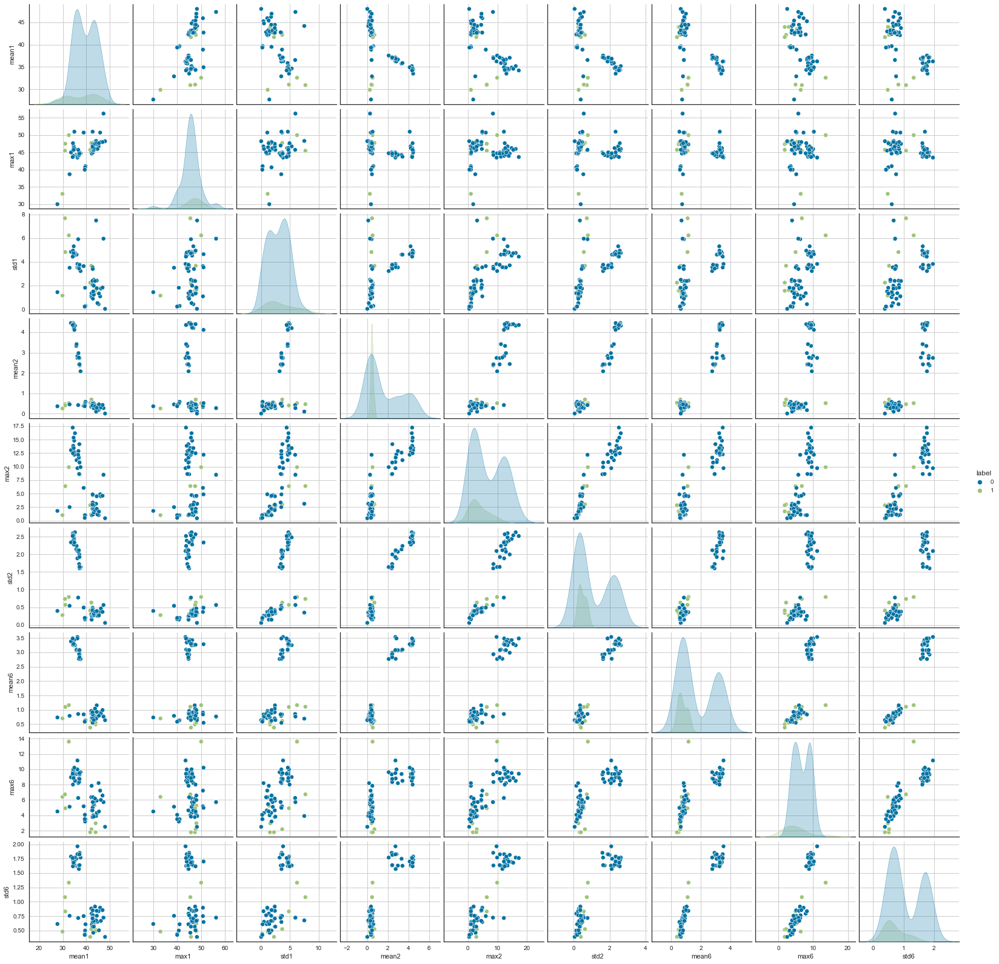

In [25]:
sns.set_style("ticks",{'axes.grid' : True})
sns.pairplot(bin_class_df_1, hue='label')

<b>(ii)</b> Break each time series in your training set into two (approximately) equal
length time series. Now instead of 6 time series for each of the training
instances, you have 12 time series for each training instance. Repeat the
experiment in 2(a)i, i.e depict scatter plots of the features extracted from both
parts of the time series 1,2, and 6. Do you see any considerable difference in
the results with those of 2(a)i?

In [26]:
train_df_1_list = []
train_df_2_list = []

In [27]:
for df in train_df_list:
    n = len(df)
    train_df_1_list.append(df[:n//2])
    train_df_2_list.append(df[n//2:])

In [28]:
features_1 = get_features_df(train_df_1_list)
features_2 = get_features_df(train_df_2_list)

In [29]:
features_2_columns = []
for column_name in features_2.columns[:-1]:
    features_2_columns.append(f"{column_name}_2")
features_2_columns.append('label')
features_2.columns = features_2_columns

In [30]:
features_2

,min1_2,max1_2,mean1_2,median1_2,std1_2,first_quartile1_2,third_quartile1_2,min2_2,max2_2,mean2_2,...,first_quartile5_2,third_quartile5_2,min6_2,max6_2,mean6_2,median6_2,std6_2,first_quartile6_2,third_quartile6_2,label
0,35.00,47.40,43.851833,43.50,1.557168,43.0000,45.00,0.0,1.70,0.471458,...,33.00,36.2500,0.0,1.50,0.388333,0.00,0.478528,0.0000,0.7100,bending
1,33.00,46.00,41.080750,42.00,3.537481,37.7500,44.50,0.0,2.86,0.718792,...,28.75,33.7500,0.0,2.18,0.586083,0.47,0.491873,0.0000,0.8700,bending
2,39.25,43.67,41.734917,41.50,0.595920,41.5000,42.00,0.0,1.12,0.448875,...,28.31,30.5625,0.0,1.50,0.347500,0.43,0.363144,0.0000,0.5000,bending
3,37.00,46.50,42.792875,42.67,1.058792,42.5000,43.00,0.0,1.58,0.506125,...,22.50,23.7500,0.0,4.06,0.543875,0.50,0.473445,0.4300,0.7100,bending
4,36.25,48.00,44.452042,44.50,1.771251,44.2500,44.75,0.0,1.50,0.447583,...,21.00,23.5000,0.0,2.96,0.585750,0.50,0.487918,0.4225,0.8300,bending
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64,36.00,47.50,43.323750,45.00,2.707181,41.6275,45.00,0.0,1.92,0.420083,...,12.50,15.8125,0.0,5.72,1.153750,0.83,1.040579,0.5000,1.3000,standing
65,37.50,47.75,44.646000,45.00,1.603257,45.0000,45.33,0.0,2.18,0.325042,...,12.00,13.8125,0.0,4.32,0.889375,0.83,0.775612,0.4300,1.1200,standing
66,37.75,48.00,47.389875,48.00,1.298702,47.5000,48.00,0.0,3.35,0.207458,...,10.75,15.0000,0.0,6.00,0.910833,0.83,0.799981,0.4700,1.2200,standing
67,29.75,48.00,46.357250,47.50,2.399503,45.5000,47.75,0.0,4.60,0.430500,...,13.67,16.5000,0.0,5.46,0.902750,0.83,0.783585,0.4700,1.0000,standing


In [31]:
train_split_features_df = pd.concat([features_1.drop('label', axis=1), features_2], axis=1)
train_split_features_df

,min1,max1,mean1,median1,std1,first_quartile1,third_quartile1,min2,max2,mean2,...,first_quartile5_2,third_quartile5_2,min6_2,max6_2,mean6_2,median6_2,std6_2,first_quartile6_2,third_quartile6_2,label
0,36.50,46.50,44.057167,44.50,1.556971,43.2500,45.0000,0.0,1.50,0.381042,...,33.00,36.2500,0.0,1.50,0.388333,0.00,0.478528,0.0000,0.7100,bending
1,33.75,47.75,43.278875,45.00,3.473355,42.0000,45.2500,0.0,3.00,0.673292,...,28.75,33.7500,0.0,2.18,0.586083,0.47,0.491873,0.0000,0.8700,bending
2,33.00,45.75,41.621208,42.33,3.118644,39.6525,44.2500,0.0,2.83,0.623083,...,28.31,30.5625,0.0,1.50,0.347500,0.43,0.363144,0.0000,0.5000,bending
3,39.00,48.00,44.117042,45.00,1.359836,43.5000,45.0000,0.0,1.30,0.250042,...,22.50,23.7500,0.0,4.06,0.543875,0.50,0.473445,0.4300,0.7100,bending
4,36.67,45.00,43.486208,43.71,1.281976,42.3300,44.5000,0.0,1.30,0.378667,...,21.00,23.5000,0.0,2.96,0.585750,0.50,0.487918,0.4225,0.8300,bending
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64,36.00,46.75,44.116292,45.00,1.935843,44.3300,45.0000,0.0,1.79,0.313333,...,12.50,15.8125,0.0,5.72,1.153750,0.83,1.040579,0.5000,1.3000,standing
65,34.50,46.33,44.296292,45.00,1.914471,44.7500,45.0000,0.0,2.12,0.255917,...,12.00,13.8125,0.0,4.32,0.889375,0.83,0.775612,0.4300,1.1200,standing
66,35.50,47.00,45.060000,45.33,1.309144,45.0000,45.5425,0.0,4.50,0.417250,...,10.75,15.0000,0.0,6.00,0.910833,0.83,0.799981,0.4700,1.2200,standing
67,41.25,48.00,47.507167,47.50,0.556636,47.5000,47.7500,0.0,2.59,0.428833,...,13.67,16.5000,0.0,5.46,0.902750,0.83,0.783585,0.4700,1.0000,standing


In [32]:
bin_class_df_2 = train_split_features_df[
    [
        'mean1', 'max1', 'std1', 'mean2', 'max2', 'std2', 'mean6', 'max6', 'std6', 
        'mean1_2', 'max1_2', 'std1_2', 'mean2_2', 'max2_2', 'std2_2', 'mean6_2', 'max6_2', 'std6_2', 
        'label'     
    ]
]

In [33]:
bin_class_df_2['label'] = bin_class_df_2['label'].apply(label_transformation)
bin_class_df_2

,mean1,max1,std1,mean2,max2,std2,mean6,max6,std6,mean1_2,max1_2,std1_2,mean2_2,max2_2,std2_2,mean6_2,max6_2,std6_2,label
0,44.057167,46.50,1.556971,0.381042,1.50,0.329540,0.598250,1.79,0.526656,43.851833,47.40,1.557168,0.471458,1.70,0.342346,0.388333,1.50,0.478528,1
1,43.278875,47.75,3.473355,0.673292,3.00,0.634285,0.640958,1.53,0.554542,41.080750,46.00,3.537481,0.718792,2.86,0.627915,0.586083,2.18,0.491873,1
2,41.621208,45.75,3.118644,0.623083,2.83,0.489595,0.419083,1.79,0.411200,41.734917,43.67,0.595920,0.448875,1.12,0.273050,0.347500,1.50,0.363144,1
3,44.117042,48.00,1.359836,0.250042,1.30,0.314099,0.815417,5.26,0.718016,42.792875,46.50,1.058792,0.506125,1.58,0.260761,0.543875,4.06,0.473445,1
4,43.486208,45.00,1.281976,0.378667,1.30,0.284434,0.524875,2.28,0.486847,44.452042,48.00,1.771251,0.447583,1.50,0.235493,0.585750,2.96,0.487918,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64,44.116292,46.75,1.935843,0.313333,1.79,0.347747,0.925625,6.18,0.758355,43.323750,47.50,2.707181,0.420083,1.92,0.392253,1.153750,5.72,1.040579,0
65,44.296292,46.33,1.914471,0.255917,2.12,0.405758,0.965375,4.32,0.736418,44.646000,47.75,1.603257,0.325042,2.18,0.377320,0.889375,4.32,0.775612,0
66,45.060000,47.00,1.309144,0.417250,4.50,0.491716,0.854333,3.00,0.503862,47.389875,48.00,1.298702,0.207458,3.35,0.410629,0.910833,6.00,0.799981,0
67,47.507167,48.00,0.556636,0.428833,2.59,0.242591,1.079500,6.58,0.914629,46.357250,48.00,2.399503,0.430500,4.60,0.459872,0.902750,5.46,0.783585,0


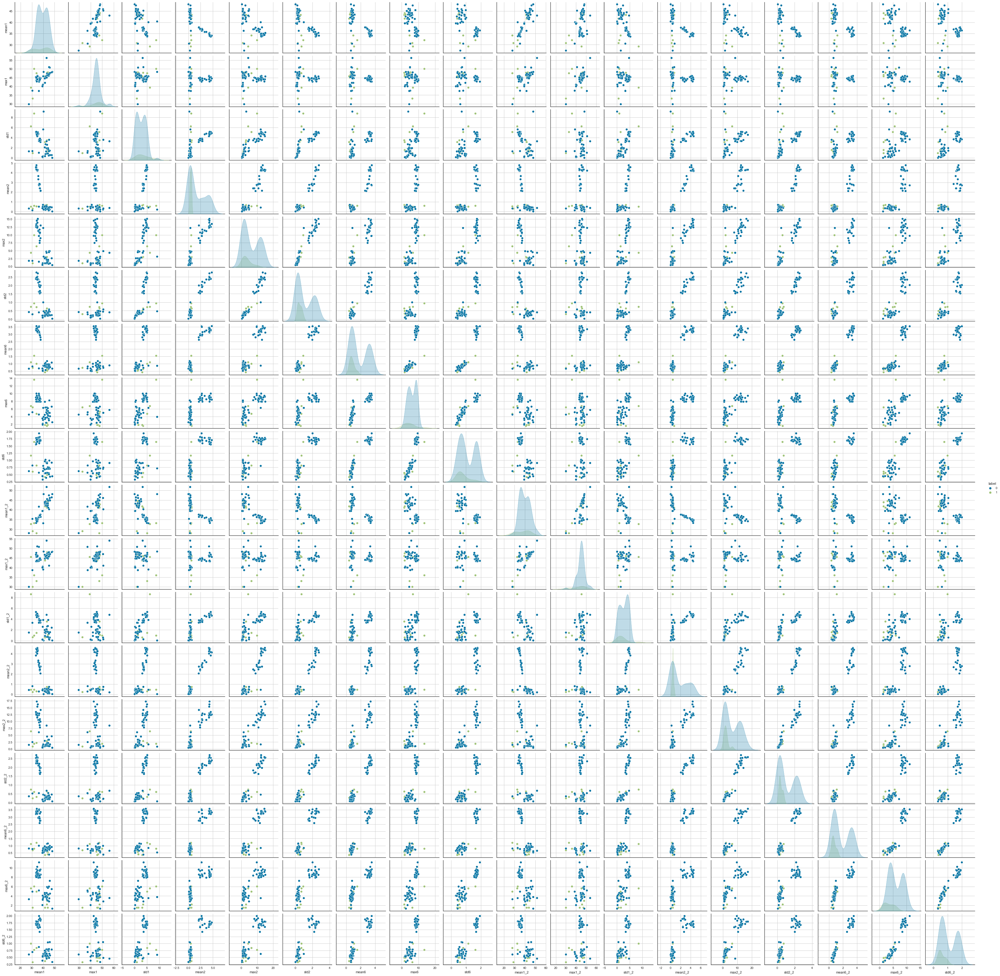

In [34]:
sns.pairplot(bin_class_df_2, hue='label')

<b>We can notice, that there is no significant difference in the two scatter plots. However, the bending class is slightly more separated and visible than before.</b>

<b>(iii)</b>. Break each time series in your training set into l in set {1, 2, ..., 20} time series of approximately equal length and use logistic regression to solve the binary classification problem, using time-domain features. Remember that breaking each of the time series does not change the number of instances. It only changes the number of features for each instance. Calculate the p-values for your logistic regression parameters in each model corresponding to each value of l and refit a logistic regression model using your pruned set of features.
Alternatively, you can use backward selection using sklearn.feature selection or glm in R. Use 5-fold cross-validation to determine the best value of the pair (l, p), where p is the number of features used in recursive feature elimination. Explain what the right way and the wrong way are to perform cross-validation in this problem. Obviously, use the right way! Also, you may encounter the problem of class imbalance, which may make some of your folds not having any instances of the rare class. In such a case, you can use stratified cross validation. Research what it means and use it if needed.
In the following, you can see an example of applying Python's Recursive Feature Elimination, which is a backward selection algorithm, to logistic regression.
#Recursive Feature Elimination code...

In [35]:
def get_features_from_split_data(list_of_df, L):
    
    train_features_list_per_L = []
    
    def break_and_make_data(df, p):
        
        length = len(df) - len(df)%p
        parts_size = length//p
        final_df = pd.DataFrame()
        ret_df_list = []
        for i in range(0,length,parts_size):
            df_part = df.loc[i:i+parts_size-1,:]    
            ret_df_list.append(df_part)
        return ret_df_list
    
    for len_ in range(1,L+1):
        features_list = []
        for df in list_of_df:
            final_df_list = break_and_make_data(df,len_)
            extracted_features = []
            for mult_df in final_df_list:
                features_df=get_features_df([mult_df])
                extracted_features.append(features_df)
            feature_df=pd.concat(extracted_features, axis=1)
            features_list.append(feature_df)
        concatenated_df = pd.concat(features_list, axis=0)
        if len_ > 1:
            label_column = concatenated_df['label'].iloc[:,0]
            concatenated_df.drop('label', inplace=True, axis = 1)
            concatenated_df['label'] = label_column
        train_features_list_per_L.append(concatenated_df)
    return train_features_list_per_L        

In [36]:
train_features_list_per_L = get_features_from_split_data(train_df_list, 20)

In [37]:
for features_df in train_features_list_per_L:
    features_df['label'] = features_df['label'].apply(label_transformation)

In [38]:
for L, feature_df in enumerate(train_features_list_per_L):
    
    train_X = feature_df.iloc[:,:-1]
    train_Y = feature_df['label']
    
    model = LogisticRegression(max_iter=100)
    validator = StratifiedKFold(n_splits=5)
    selector = RFECV(estimator=model, cv=validator, scoring='accuracy')
    selector.fit(train_X, train_Y)
    print(f"For L={L+1} Optimal No. Of Features p = {selector.n_features_}")
    print(f"Maximum Cross-Validation Score obtained is {np.max(selector.grid_scores_)}")
    print('-'*100)

For L=1 Optimal No. Of Features p = 11
Maximum Cross-Validation Score obtained is 1.0
----------------------------------------------------------------------------------------------------
For L=2 Optimal No. Of Features p = 6
Maximum Cross-Validation Score obtained is 1.0
----------------------------------------------------------------------------------------------------
For L=3 Optimal No. Of Features p = 1
Maximum Cross-Validation Score obtained is 1.0
----------------------------------------------------------------------------------------------------
For L=4 Optimal No. Of Features p = 11
Maximum Cross-Validation Score obtained is 1.0
----------------------------------------------------------------------------------------------------
For L=5 Optimal No. Of Features p = 9
Maximum Cross-Validation Score obtained is 1.0
----------------------------------------------------------------------------------------------------
For L=6 Optimal No. Of Features p = 13
Maximum Cross-Validation Scor

#### The wrong way would be to first find the best features and then cross validating only those features for different values of l. However, I have opted for the right way where I am first checking for all different values of L and then going to the cross validation step to find the best value of l and the number of features.
#### I am choosing L=1 to go forward for the confusion matrix

<b>(iv)</b>. Report the confusion matrix and show the ROC and AUC for your classifier on train data. Report the parameters of your logistic regression betas as well as the p-values associated with them.

In [39]:
data = train_features_list_per_L[0]
train_X = data.iloc[:,:-1]
train_Y = data['label']
model = LogisticRegression(max_iter=100)
validator = StratifiedKFold(n_splits=5)
selector = RFECV(estimator=model, cv=validator, scoring='accuracy')
selector.fit(train_X, train_Y)

RFECV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
      estimator=LogisticRegression(), scoring='accuracy')

In [40]:
y_pred = selector.predict(train_X)
print("Accuracy: ",accuracy_score(train_Y,y_pred))

Accuracy:  1.0


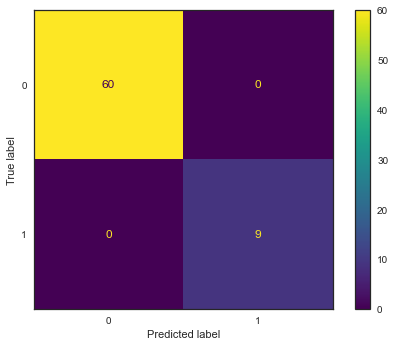

In [41]:
sns.set_style("ticks",{'axes.grid' : False})
disp = ConfusionMatrixDisplay(confusion_matrix(train_Y, y_pred, labels=selector.classes_), display_labels=selector.classes_)
disp.plot()

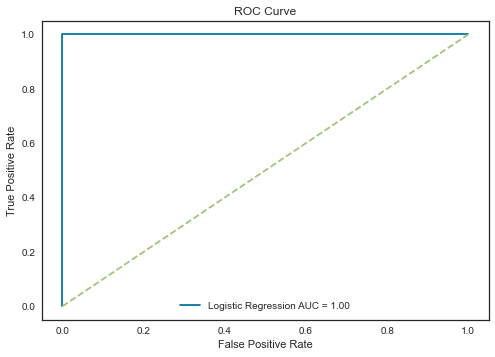

In [42]:
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
fpr, tpr, __= roc_curve(train_Y, selector.predict_proba(train_X)[:,1])
plt.plot(fpr, tpr, label='Logistic Regression AUC = %0.02f' % roc_auc_score(train_Y, y_pred))
plt.plot([0, 1], [0, 1],'g--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower center")
plt.show()

In [43]:
selector.n_features_

11

In [44]:
selector.estimator_.coef_

array([[-0.24291078, -0.25051088, -0.24872576, -0.26058042, -0.24125947,
         0.35021045,  0.68110854,  0.23532712,  0.14837612,  0.20304244,
         0.17380443]])

In [45]:
features = [feature + str(i) for i in range(1, 6 * 1 + 1) for feature in ['min','max','mean','median','std','first_quartile', 'third_quartile']]
selected_feature = [feature for i, feature in enumerate(features) if selector.support_[i]]

In [46]:
trainX_constant = sm.add_constant(train_X.loc[:, selected_feature].to_numpy(dtype=float))
model_1 = sm.Logit(train_Y.to_numpy(dtype=float), trainX_constant)
logit_results = model_1.fit(method='bfgs')
print(logit_results.summary())

Optimization terminated successfully.
         Current function value: 0.000001
         Iterations: 22
         Function evaluations: 26
         Gradient evaluations: 26
                           Logit Regression Results                           
Dep. Variable:                      y   No. Observations:                   69
Model:                          Logit   Df Residuals:                       57
Method:                           MLE   Df Model:                           11
Date:                Thu, 20 Oct 2022   Pseudo R-squ.:                   1.000
Time:                        03:44:41   Log-Likelihood:            -6.2392e-05
converged:                       True   LL-Null:                       -26.718
Covariance Type:            nonrobust   LLR p-value:                 1.496e-07
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.4859   1.36e+05  -3.5

<b>(v)</b>. Test the classifier on the test set. Remember to break the time series in your test set into the same number of time series into which you broke your training set. Remember that the classifier has to be tested using the features extracted from the test set. Compare the accuracy on the test set with the cross-validation accuracy you obtained previously.

In [47]:
test_features_L_0 = get_features_from_split_data(test_df_list, 1)

In [48]:
data = test_features_L_0[0]
data['label'] = data['label'].apply(label_transformation)

In [49]:
test_X = data.iloc[:,:-1]
test_Y = data['label']

In [50]:
y_pred = selector.predict(test_X)
print("Accuracy: ",accuracy_score(test_Y,y_pred))

Accuracy:  1.0


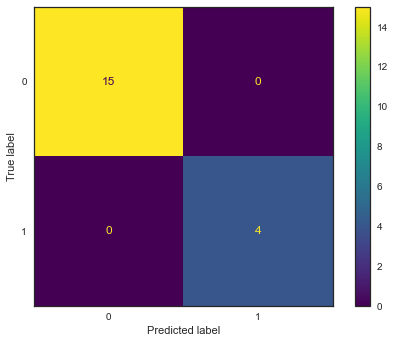

In [51]:
sns.set_style("ticks",{'axes.grid' : False})
disp = ConfusionMatrixDisplay(confusion_matrix(test_Y, y_pred, labels=selector.classes_), display_labels=selector.classes_)
disp.plot()

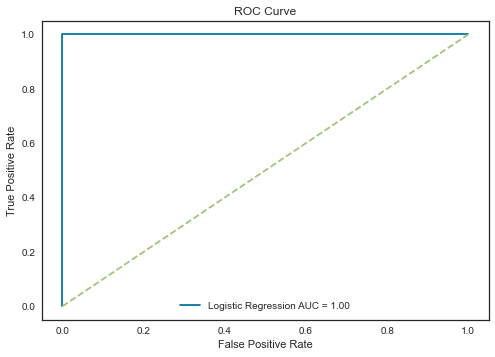

In [52]:
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
fpr, tpr, __= roc_curve(test_Y, selector.predict_proba(test_X)[:,1])
plt.plot(fpr, tpr, label='Logistic Regression AUC = %0.02f' % roc_auc_score(test_Y, y_pred))
plt.plot([0, 1], [0, 1],'g--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower center")
plt.show()

### This shows that model is performing well. We are getting good results for both cross-validation and test sets

**(vi)**. Do your classes seem to be well-separated to cause instability in calculating logistic regression parameters

**Answer**: <br>
**Yes. The summary of `statmodels` has following statement**
> Complete Separation: The results show that there is complete separation.
In this case the Maximum Likelihood Estimator does not exist and the parameters
are not identified.

**(vii)**. From the confusion matrices you obtained, do you see imbalanced classes? If yes, build a logistic regression model based on case-control sampling and adjust its parameters. Report the confusion matrix, ROC, and AUC of the model.

#### Yes. This can be seen from confusion matrix where there are 9 bending and 60 not bending cases in training set. This is indeed class imbalance


In [53]:
data = train_features_list_per_L[0]
train_X = data.iloc[:,:-1]
train_Y = data['label']

In [54]:
oversampler = RandomOverSampler(random_state=42)
train_X_balanced, train_Y_balanced = oversampler.fit_resample(train_X, train_Y)

In [55]:
arr = train_Y_balanced == 0

In [56]:
count_bending = 0
count_not_bending = 0
for case in arr:
    if case:
        count_bending += 1
    else:
        count_not_bending += 1

In [57]:
count_bending

60

In [58]:
count_not_bending

60

Now we can see that both the cases have equal cases

In [59]:
model = LogisticRegression(max_iter=100)
model.fit(train_X_balanced, train_Y_balanced)

LogisticRegression()

In [60]:
y_pred_balanced = selector.predict(train_X_balanced)
print("Accuracy: ",accuracy_score(train_Y_balanced,y_pred_balanced))

Accuracy:  1.0


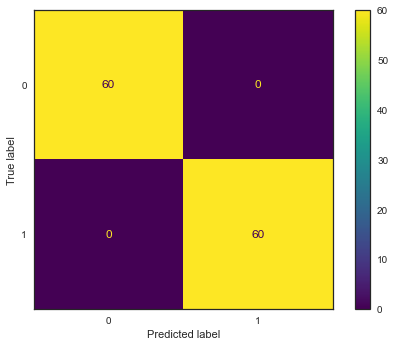

In [61]:
sns.set_style("ticks",{'axes.grid' : False})
disp = ConfusionMatrixDisplay(confusion_matrix(train_Y_balanced, y_pred_balanced, labels=model.classes_), display_labels=model.classes_)
disp.plot()

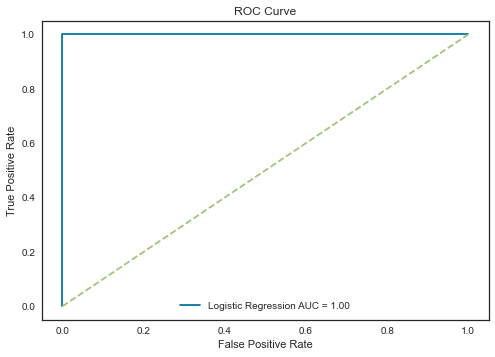

In [62]:
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
fpr, tpr, __= roc_curve(train_Y_balanced, selector.predict_proba(train_X_balanced)[:,1])
plt.plot(fpr, tpr, label='Logistic Regression AUC = %0.02f' % roc_auc_score(train_Y_balanced, y_pred_balanced))
plt.plot([0, 1], [0, 1],'g--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower center")
plt.show()

In [63]:
y_pred = model.predict(test_X)
print("Accuracy: ",accuracy_score(test_Y,y_pred))

Accuracy:  1.0


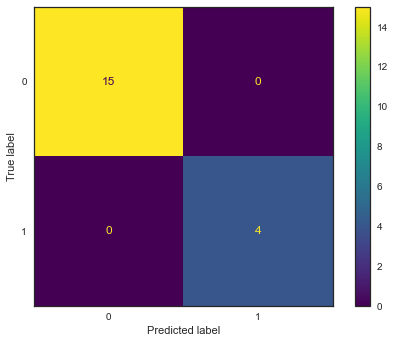

In [64]:
sns.set_style("ticks",{'axes.grid' : False})
disp = ConfusionMatrixDisplay(confusion_matrix(test_Y, y_pred, labels=model.classes_), display_labels=model.classes_)
disp.plot()

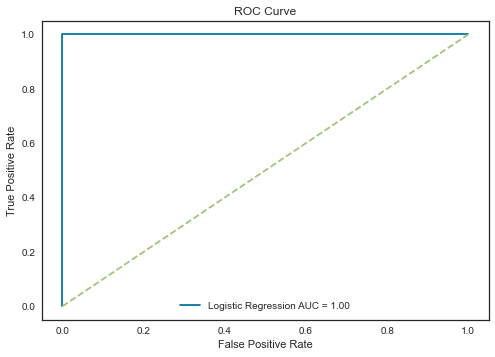

In [65]:
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
fpr, tpr, __= roc_curve(test_Y, model.predict_proba(test_X)[:,1])
plt.plot(fpr, tpr, label='Logistic Regression AUC = %0.02f' % roc_auc_score(test_Y, y_pred))
plt.plot([0, 1], [0, 1],'g--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower center")
plt.show()

#### We are getting good results after case control sampling

### (b) Binary Classification Using L1-penalized logistic regression


**(i)**. Repeat 2(a)iii using L1-penalized logistic regression,8 i.e. instead of using pvalues for variable selection, use L1 regularization. Note that in this problem, you have to cross-validate for both l, the number of time series into which you break each of your instances, and lambda, the weight of L1 penalty in your logistic regression objective function (or C, the budget). Packages usually perform cross-validation for lambda automatically.

In [66]:
test_features_list_per_L = get_features_from_split_data(test_df_list, 20)

In [67]:
test_features_list_per_L[-1]

,min1,max1,mean1,median1,std1,first_quartile1,third_quartile1,min2,max2,mean2,...,first_quartile5,third_quartile5,min6,max6,mean6,median6,std6,first_quartile6,third_quartile6,label
0,39.00,40.67,39.673750,39.500,0.488439,39.4375,39.8150,0.00,0.83,0.474583,...,30.0000,30.6250,0.00,0.94,0.227500,0.000,0.304634,0.0000,0.4300,bending
0,41.75,44.25,43.437917,43.500,0.530987,43.4575,43.6700,0.43,0.83,0.524583,...,31.3100,33.0000,0.00,1.50,0.332917,0.430,0.364220,0.0000,0.4400,bending
0,14.00,24.33,19.420000,19.625,3.153746,17.4375,21.4350,0.00,4.92,1.450000,...,19.7125,21.2700,0.00,1.09,0.554167,0.495,0.293671,0.4300,0.8300,bending
0,26.50,27.25,26.989583,27.000,0.116076,27.0000,27.0000,0.00,0.50,0.038750,...,24.6875,27.0625,0.50,4.06,2.225417,1.710,1.150705,1.3000,3.2700,bending
0,30.75,43.25,36.107500,34.500,4.129581,32.7500,40.5000,0.00,6.18,2.463333,...,18.0000,21.8125,0.87,7.79,2.698750,2.470,1.651232,1.4100,3.3700,cycling
0,30.75,44.00,36.909583,35.500,4.035417,34.2075,41.0625,0.00,5.89,2.438333,...,14.5625,18.1875,1.25,5.83,3.147083,3.110,1.359256,2.1925,3.9450,cycling
0,29.00,44.00,37.587083,37.250,4.027073,34.4375,40.7525,0.00,6.40,2.443333,...,15.7500,21.0825,0.00,8.98,3.483333,2.620,2.423070,1.5975,4.8475,cycling
0,41.75,42.00,41.979167,42.000,0.070582,42.0000,42.0000,0.00,0.43,0.035833,...,15.7300,18.0000,0.00,5.79,1.089583,0.765,1.330379,0.4300,0.9550,sitting
0,42.00,42.00,42.000000,42.000,0.000000,42.0000,42.0000,0.00,0.00,0.000000,...,14.1850,21.3125,0.00,6.18,1.454167,0.885,1.433788,0.5000,1.6050,sitting
0,36.25,44.33,39.411250,38.000,2.517292,37.7300,41.8025,0.00,2.95,0.980417,...,11.4575,14.6900,0.00,3.83,1.223750,1.105,0.788051,0.8275,1.3700,sitting


In [68]:
for features_df in test_features_list_per_L:
    features_df['label'] = features_df['label'].apply(label_transformation)

In [69]:
test_features_list_per_L[-1]

,min1,max1,mean1,median1,std1,first_quartile1,third_quartile1,min2,max2,mean2,...,first_quartile5,third_quartile5,min6,max6,mean6,median6,std6,first_quartile6,third_quartile6,label
0,39.00,40.67,39.673750,39.500,0.488439,39.4375,39.8150,0.00,0.83,0.474583,...,30.0000,30.6250,0.00,0.94,0.227500,0.000,0.304634,0.0000,0.4300,1
0,41.75,44.25,43.437917,43.500,0.530987,43.4575,43.6700,0.43,0.83,0.524583,...,31.3100,33.0000,0.00,1.50,0.332917,0.430,0.364220,0.0000,0.4400,1
0,14.00,24.33,19.420000,19.625,3.153746,17.4375,21.4350,0.00,4.92,1.450000,...,19.7125,21.2700,0.00,1.09,0.554167,0.495,0.293671,0.4300,0.8300,1
0,26.50,27.25,26.989583,27.000,0.116076,27.0000,27.0000,0.00,0.50,0.038750,...,24.6875,27.0625,0.50,4.06,2.225417,1.710,1.150705,1.3000,3.2700,1
0,30.75,43.25,36.107500,34.500,4.129581,32.7500,40.5000,0.00,6.18,2.463333,...,18.0000,21.8125,0.87,7.79,2.698750,2.470,1.651232,1.4100,3.3700,0
0,30.75,44.00,36.909583,35.500,4.035417,34.2075,41.0625,0.00,5.89,2.438333,...,14.5625,18.1875,1.25,5.83,3.147083,3.110,1.359256,2.1925,3.9450,0
0,29.00,44.00,37.587083,37.250,4.027073,34.4375,40.7525,0.00,6.40,2.443333,...,15.7500,21.0825,0.00,8.98,3.483333,2.620,2.423070,1.5975,4.8475,0
0,41.75,42.00,41.979167,42.000,0.070582,42.0000,42.0000,0.00,0.43,0.035833,...,15.7300,18.0000,0.00,5.79,1.089583,0.765,1.330379,0.4300,0.9550,0
0,42.00,42.00,42.000000,42.000,0.000000,42.0000,42.0000,0.00,0.00,0.000000,...,14.1850,21.3125,0.00,6.18,1.454167,0.885,1.433788,0.5000,1.6050,0
0,36.25,44.33,39.411250,38.000,2.517292,37.7300,41.8025,0.00,2.95,0.980417,...,11.4575,14.6900,0.00,3.83,1.223750,1.105,0.788051,0.8275,1.3700,0


In [70]:
#https://www.rasgoml.com/feature-engineering-tutorials/how-to-do-scikit-learn-stratified-cross-validation-splits

X_list = []
Y = pd.DataFrame(pd.concat([train_features_list_per_L[0]['label'],test_features_list_per_L[0]['label']]))

for i in range(20):
    X_list.append(pd.concat([train_features_list_per_L[i].iloc[:, :-1],test_features_list_per_L[i].iloc[:, :-1]]))

AUC_per_L = []
accuracy_per_L = []
lambda_per_L = []
for L in range(1,21):
    x_data=X_list[L-1].loc[:]
    scalar=MinMaxScaler()
    normalized=scalar.fit_transform(x_data.values)
    x_data=pd.DataFrame(normalized,columns=x_data.columns)
    AUCs=[]
    accuracies=[]
    lambdas=[]
    st_kfcv = StratifiedKFold(n_splits=5,shuffle=False)
    for train_index,val_index in st_kfcv.split(x_data,Y):
        X_train, X_val = x_data.iloc[train_index.tolist(),:], x_data.iloc[val_index.tolist(),:]
        y_train, y_val = Y.iloc[train_index.tolist(),:], Y.iloc[val_index.tolist(),:]
        regressor = LogisticRegressionCV(Cs=10,penalty='l1',solver='liblinear')
        regressor.fit(X_train, y_train)
        y_pred= regressor.predict(X_val)
        fpr, tpr, _ = roc_curve(y_val,y_pred)
        AUCs.append(auc(fpr, tpr))
        accuracies.append(regressor.score(X_val,y_val))
        lambdas.append(regressor.C_)
    AUC_per_L.append(AUCs)
    accuracy_per_L.append(accuracies)
    lambda_per_L.append(lambdas)        

In [72]:
stats_logistic_L1 = pd.DataFrame({"L":list(range(1,21)),"C ":lambda_per_L,"AUC":AUC_per_L,"Accuracy":accuracy_per_L})
maximum_accuracy=list()
for accr in stats_logistic_L1['Accuracy']:
    maximum_accuracy.append(max(accr))
stats_logistic_L1['maximum_accuracy']=maximum_accuracy

In [73]:
optimal_conf = stats_logistic_L1[stats_logistic_L1['maximum_accuracy']==1]

In [74]:
optimal_conf

,L,C,AUC,Accuracy,maximum_accuracy
0,1,"[[166.81005372000558], [21.54434690031882], [2...","[1.0, 0.6333333333333333, 0.8333333333333333, ...","[1.0, 0.8333333333333334, 0.9444444444444444, ...",1.0
1,2,"[[166.81005372000558], [1291.5496650148827], [...","[1.0, 0.6333333333333333, 1.0, 1.0, 0.75]","[1.0, 0.8333333333333334, 1.0, 1.0, 0.94117647...",1.0
2,3,"[[21.54434690031882], [10000.0], [2.7825594022...","[1.0, 0.7666666666666666, 0.8333333333333333, ...","[1.0, 0.8333333333333334, 0.9444444444444444, ...",1.0
3,4,"[[166.81005372000558], [21.54434690031882], [1...","[1.0, 0.4666666666666667, 0.6666666666666666, ...","[1.0, 0.7777777777777778, 0.8888888888888888, ...",1.0
4,5,"[[21.54434690031882], [166.81005372000558], [2...","[1.0, 0.6333333333333333, 0.6666666666666666, ...","[1.0, 0.8333333333333334, 0.8888888888888888, ...",1.0
5,6,"[[2.782559402207126], [10000.0], [21.544346900...","[1.0, 0.6, 0.8333333333333333, 1.0, 0.75]","[1.0, 0.7777777777777778, 0.9444444444444444, ...",1.0
6,7,"[[1291.5496650148827], [2.782559402207126], [2...","[1.0, 0.5, 0.6666666666666666, 1.0, 0.75]","[1.0, 0.8333333333333334, 0.8888888888888888, ...",1.0
7,8,"[[2.782559402207126], [10000.0], [2.7825594022...","[1.0, 0.6, 0.6666666666666666, 1.0, 1.0]","[1.0, 0.7777777777777778, 0.8888888888888888, ...",1.0
8,9,"[[21.54434690031882], [10000.0], [2.7825594022...","[1.0, 0.6, 0.6333333333333333, 1.0, 0.75]","[1.0, 0.7777777777777778, 0.8333333333333334, ...",1.0
9,10,"[[21.54434690031882], [10000.0], [2.7825594022...","[1.0, 0.6, 0.6666666666666666, 1.0, 0.75]","[1.0, 0.7777777777777778, 0.8888888888888888, ...",1.0


In [76]:
list(optimal_conf[optimal_conf['L']==1].iloc[:, 1])

[[array([166.81005372]),
  array([21.5443469]),
  array([21.5443469]),
  array([166.81005372]),
  array([166.81005372])]]

In [77]:
X_train = train_features_list_per_L[0].iloc[:, :-1]
Y_train = train_features_list_per_L[0]['label']
X_test = test_features_list_per_L[0].iloc[:, :-1]
Y_test = test_features_list_per_L[0]['label']

In [78]:
logistic_regressor = LogisticRegressionCV(Cs=10,penalty='l1',solver='liblinear')
logistic_regressor.fit(X_train, Y_train) 

LogisticRegressionCV(penalty='l1', solver='liblinear')

In [79]:
y_pred = logistic_regressor.predict(X_test)
print("Accuracy: ",accuracy_score(Y_test,y_pred))

Accuracy:  1.0


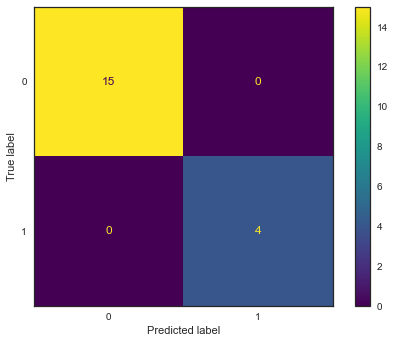

In [80]:
sns.set_style("ticks",{'axes.grid' : False})
disp = ConfusionMatrixDisplay(confusion_matrix(Y_test, y_pred, labels=logistic_regressor.classes_), display_labels=logistic_regressor.classes_)
disp.plot()

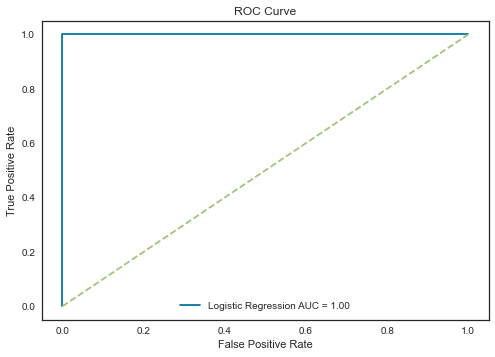

In [81]:
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
fpr, tpr, __= roc_curve(Y_test, model.predict_proba(X_test)[:,1])
plt.plot(fpr, tpr, label='Logistic Regression AUC = %0.02f' % roc_auc_score(Y_test, y_pred))
plt.plot([0, 1], [0, 1],'g--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower center")
plt.show()

**(ii)**. Compare the L1-penalized with variable selection using p-values. Which one performs better? Which one is easier to implement?


- **I think that L1 penalized model is much easier to implement. The performance of both the models is similar.**

- **The L1-regularization seems to be easier for implementation as we dont have to select features manually using p-value which is an intensive process. Also, The sharper edges of L1 constrain helps to select features naturally.**

### (c) Multi-class Classification (The Realistic Case)


**(i)** Find the best l in the same way as you found it in 2(b)i to build an L1-penalized multinomial regression model to classify all activities in your training set. Report your test error. Research how confusion matrices and ROC curves are defined for multiclass classification and show them for this problem if possible.


In [82]:
train_features_list_per_L = get_features_from_split_data(train_df_list, 20)
test_features_list_per_L = get_features_from_split_data(test_df_list, 20)

In [83]:
def label_transformation_multiclass(label):
    if label == 'bending':
        return 1
    elif label == 'cycling':
        return 2
    elif label == 'sitting':
        return 3
    elif label == 'lying':
        return 4
    elif label == 'walking':
        return 5
    elif label == 'standing':
        return 6

In [84]:
X = list()
Y = list()
for i in range(20):
    X.append(pd.concat([train_features_list_per_L[i].iloc[:, :-1],test_features_list_per_L[i].iloc[:, :-1]]))
    Y.append(pd.concat([train_features_list_per_L[i]['label'], test_features_list_per_L[i]['label']]))    
    

In [123]:
#https://www.rasgoml.com/feature-engineering-tutorials/how-to-do-scikit-learn-stratified-cross-validation-splits

X_list = []
Y = pd.DataFrame(pd.concat([train_features_list_per_L[0]['label'],test_features_list_per_L[0]['label']]))
Y['label'] = Y['label'].apply(label_transformation_multiclass)
for i in range(20):
    X_list.append(pd.concat([train_features_list_per_L[i].iloc[:, :-1],test_features_list_per_L[i].iloc[:, :-1]]))

accuracy_per_L = []
for L in range(1,21):
    x_data=X_list[L-1].loc[:]
    scalar=MinMaxScaler()
    normalized=scalar.fit_transform(x_data.values)
    x_data=pd.DataFrame(normalized,columns=x_data.columns)
    accuracies=[]
    lambdas=[]
    st_kfcv = StratifiedKFold(n_splits=5,shuffle=False)
    for train_index,val_index in st_kfcv.split(x_data,Y):
        X_train, X_val = x_data.iloc[train_index.tolist(),:], x_data.iloc[val_index.tolist(),:]
        y_train, y_val = Y.iloc[train_index.tolist(),:], Y.iloc[val_index.tolist(),:]
        regressor = LogisticRegressionCV(Cs=10,penalty='l1',solver='liblinear')
        regressor.fit(X_train, y_train)
        y_pred= regressor.predict(X_val)
        accuracies.append(regressor.score(X_val,y_val))
    accuracy_per_L.append(accuracies)

In [124]:
stats_logistic_L1_multiclass = pd.DataFrame({"L":list(range(1,21)),"Accuracy":accuracy_per_L})
maximum_accuracy=list()
for accr in stats_logistic_L1_multiclass['Accuracy']:
    maximum_accuracy.append(max(accr))
stats_logistic_L1_multiclass['maximum_accuracy']=maximum_accuracy
stats_logistic_L1_multiclass

,L,Accuracy,maximum_accuracy
0,1,"[0.8333333333333334, 0.7777777777777778, 0.944...",0.944444
1,2,"[0.9444444444444444, 0.8333333333333334, 0.722...",0.944444
2,3,"[0.8888888888888888, 0.8333333333333334, 0.666...",0.941176
3,4,"[0.7777777777777778, 0.7777777777777778, 0.722...",0.941176
4,5,"[0.8888888888888888, 0.7777777777777778, 0.722...",0.888889
5,6,"[0.7777777777777778, 0.8333333333333334, 0.722...",0.941176
6,7,"[0.7777777777777778, 0.8333333333333334, 0.777...",0.833333
7,8,"[0.7777777777777778, 0.8333333333333334, 0.722...",0.882353
8,9,"[0.7222222222222222, 0.7777777777777778, 0.722...",0.882353
9,10,"[0.7777777777777778, 0.8333333333333334, 0.666...",0.941176


### As can be observed, getting max accuracy at L = 1

In [125]:
# using L=1(index = L-1= 0) now
X_train = train_features_list_per_L[0].iloc[:, :-1]
Y_train = train_features_list_per_L[0]['label']
X_test = test_features_list_per_L[0].iloc[:, :-1]
Y_test = test_features_list_per_L[0]['label']

In [126]:
logistic_regressor = LogisticRegressionCV(Cs=10,penalty='l1',solver='liblinear')
logistic_regressor.fit(X_train, Y_train) 

LogisticRegressionCV(penalty='l1', solver='liblinear')

In [127]:
y_pred = logistic_regressor.predict(X_test)
print("Accuracy: ",accuracy_score(Y_test,y_pred))

Accuracy:  0.8421052631578947


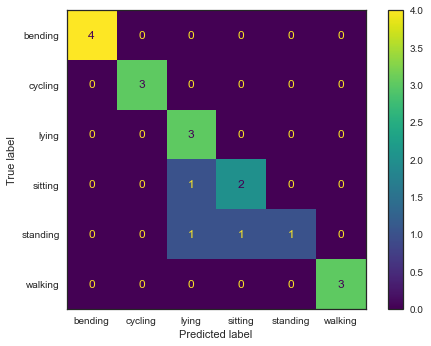

In [128]:
sns.set_style("ticks",{'axes.grid' : False})
disp = ConfusionMatrixDisplay(confusion_matrix(Y_test, y_pred, labels=logistic_regressor.classes_), display_labels=logistic_regressor.classes_)

disp.plot()

In [129]:
# found a stackoverflow link as below. Reusing it
# Reference for multiclass AUC: https://stackoverflow.com/questions/39685740/calculate-sklearn-roc-auc-score-for-multi-class


def class_report(y_true, y_pred, y_score=None, average='micro'):
    if y_true.shape != y_pred.shape:
        print("Error! y_true %s is not the same shape as y_pred %s" % (
              y_true.shape,
              y_pred.shape)
        )
        return

    lb = LabelBinarizer()

    if len(y_true.shape) == 1:
        lb.fit(y_true)

    #Value counts of predictions
    labels, cnt = np.unique(
        y_pred,
        return_counts=True)
    n_classes = len(labels)
    pred_cnt = pd.Series(cnt, index=labels)

    metrics_summary = precision_recall_fscore_support(
            y_true=y_true,
            y_pred=y_pred,
            labels=labels)

    avg = list(precision_recall_fscore_support(
            y_true=y_true, 
            y_pred=y_pred,
            average='weighted'))

    metrics_sum_index = ['precision', 'recall', 'f1-score', 'support']
    class_report_df = pd.DataFrame(
        list(metrics_summary),
        index=metrics_sum_index,
        columns=labels)

    support = class_report_df.loc['support']
    total = support.sum() 
    class_report_df['avg / total'] = avg[:-1] + [total]

    class_report_df = class_report_df.T
    class_report_df['pred'] = pred_cnt
    class_report_df['pred'].iloc[-1] = total

    if not (y_score is None):
        fpr = dict()
        tpr = dict()
        roc_auc = dict()
        for label_it, label in enumerate(labels):
            fpr[label], tpr[label], _ = roc_curve(
                (y_true == label).astype(int), 
                y_score[:, label_it])

            roc_auc[label] = auc(fpr[label], tpr[label])

        if average == 'micro':
            if n_classes <= 2:
                fpr["avg / total"], tpr["avg / total"], _ = roc_curve(
                    lb.transform(y_true).ravel(), 
                    y_score[:, 1].ravel())
            else:
                fpr["avg / total"], tpr["avg / total"], _ = roc_curve(
                        lb.transform(y_true).ravel(), 
                        y_score.ravel())

            roc_auc["avg / total"] = auc(
                fpr["avg / total"], 
                tpr["avg / total"])

        elif average == 'macro':
            # First aggregate all false positive rates
            all_fpr = np.unique(np.concatenate([
                fpr[i] for i in labels]
            ))

            # Then interpolate all ROC curves at this points
            mean_tpr = np.zeros_like(all_fpr)
            for i in labels:
                mean_tpr += interp(all_fpr, fpr[i], tpr[i])

            # Finally average it and compute AUC
            mean_tpr /= n_classes

            fpr["macro"] = all_fpr
            tpr["macro"] = mean_tpr

            roc_auc["avg / total"] = auc(fpr["macro"], tpr["macro"])

        class_report_df['ROC Curve AUC'] = pd.Series(roc_auc)

    return class_report_df

In [130]:
auc_report = class_report(Y_test, y_pred, logistic_regressor.predict_proba(X_test))
print(auc_report)

             precision    recall  f1-score  support  pred  ROC Curve AUC
bending       1.000000  1.000000  1.000000      4.0   4.0       1.000000
cycling       1.000000  1.000000  1.000000      3.0   3.0       1.000000
lying         0.600000  1.000000  0.750000      3.0   5.0       0.937500
sitting       0.666667  0.666667  0.666667      3.0   3.0       0.916667
standing      1.000000  0.333333  0.500000      3.0   1.0       0.833333
walking       1.000000  1.000000  1.000000      3.0   3.0       1.000000
avg / total   0.884211  0.842105  0.828947     19.0  19.0       0.964543


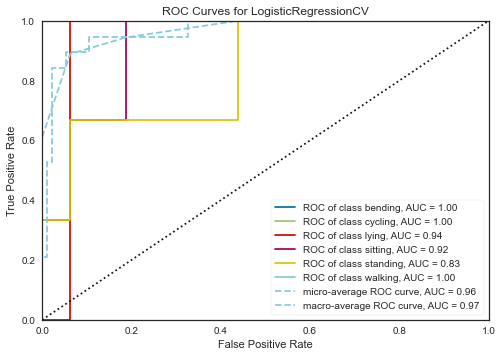

<AxesSubplot:title={'center':'ROC Curves for LogisticRegressionCV'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [131]:
# Reference: https://afioto.medium.com/classification-visualizations-with-yellowbrick-d6f6150d7a32
visualize = ROCAUC(logistic_regressor)
visualize.fit(X_train, Y_train)
visualize.score(X_test, Y_test)
visualize.show()

**(ii)**. Repeat 2(c)i using a Naive Bayes' classifier. Use both Gaussian and Multinomial priors and compare the results.

#### Gaussian Naive Bayes

In [132]:
#https://www.rasgoml.com/feature-engineering-tutorials/how-to-do-scikit-learn-stratified-cross-validation-splits

accuracy_per_L = []
for L in range(1,21):
    x_data=X_list[L-1].loc[:]
    scalar=MinMaxScaler()
    normalized=scalar.fit_transform(x_data.values)
    x_data=pd.DataFrame(normalized,columns=x_data.columns)
    accuracies=[]
    
    st_kfcv = StratifiedKFold(n_splits=5,shuffle=False)
    for train_index,val_index in st_kfcv.split(x_data,Y):
        X_train, X_val = x_data.iloc[train_index.tolist(),:], x_data.iloc[val_index.tolist(),:]
        y_train, y_val = Y.iloc[train_index.tolist(),:], Y.iloc[val_index.tolist(),:]
        regressor = GaussianNB()
        regressor.fit(X_train, y_train)
        y_pred= regressor.predict(X_val)
        accuracies.append(regressor.score(X_val,y_val))
    accuracy_per_L.append(accuracies)

In [133]:
stats_gaussian_L1_multiclass = pd.DataFrame({"L":list(range(1,21)),"Accuracy":accuracy_per_L})
maximum_accuracy = []
for accr in stats_gaussian_L1_multiclass['Accuracy']:
    maximum_accuracy.append(max(accr))
stats_gaussian_L1_multiclass['maximum_accuracy']=maximum_accuracy
stats_gaussian_L1_multiclass

,L,Accuracy,maximum_accuracy
0,1,"[0.8888888888888888, 0.9444444444444444, 0.944...",0.944444
1,2,"[0.8888888888888888, 0.9444444444444444, 0.833...",1.000000
2,3,"[0.8333333333333334, 0.8888888888888888, 0.666...",0.888889
3,4,"[0.7222222222222222, 1.0, 0.6666666666666666, ...",1.000000
4,5,"[0.6666666666666666, 0.9444444444444444, 0.777...",0.944444
5,6,"[0.7777777777777778, 0.8888888888888888, 0.722...",0.888889
6,7,"[0.6666666666666666, 0.8333333333333334, 0.666...",0.882353
7,8,"[0.7777777777777778, 0.7777777777777778, 0.722...",0.882353
8,9,"[0.7222222222222222, 1.0, 0.6111111111111112, ...",1.000000
9,10,"[0.6666666666666666, 0.9444444444444444, 0.611...",0.944444


### Proceeding with L = 2


In [134]:
# using L=2(index = L-1= 1) now
X_train = train_features_list_per_L[1].iloc[:, :-1]
Y_train = train_features_list_per_L[1]['label']
X_test = test_features_list_per_L[1].iloc[:, :-1]
Y_test = test_features_list_per_L[1]['label']

In [135]:
gaussian_regressor = GaussianNB()
gaussian_regressor.fit(X_train, Y_train) 

GaussianNB()

In [136]:
y_pred = gaussian_regressor.predict(X_test)
print("Accuracy: ",accuracy_score(Y_test,y_pred))

Accuracy:  0.7894736842105263


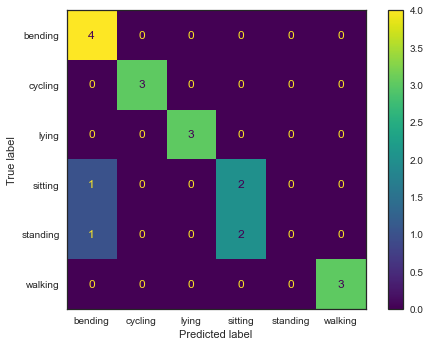

In [137]:
sns.set_style("ticks",{'axes.grid' : False})
disp = ConfusionMatrixDisplay(confusion_matrix(Y_test, y_pred, labels=gaussian_regressor.classes_), display_labels=gaussian_regressor.classes_)
disp.plot()

In [138]:
auc_report = class_report(Y_test, y_pred, gaussian_regressor.predict_proba(X_test))
print(auc_report)

             precision    recall  f1-score  support  pred  ROC Curve AUC
bending       0.666667  1.000000  0.800000      4.0   6.0       1.000000
cycling       1.000000  1.000000  1.000000      3.0   3.0       1.000000
lying         1.000000  1.000000  1.000000      3.0   3.0       1.000000
sitting       0.500000  0.666667  0.571429      3.0   4.0       0.895833
walking       1.000000  1.000000  1.000000      3.0   3.0       0.468750
avg / total   0.692982  0.789474  0.732331     16.0  16.0       0.883657


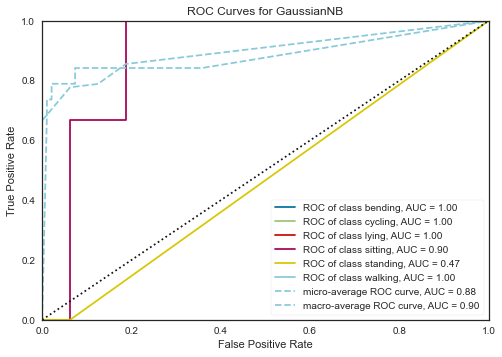

<AxesSubplot:title={'center':'ROC Curves for GaussianNB'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [139]:
# Reference: https://afioto.medium.com/classification-visualizations-with-yellowbrick-d6f6150d7a32
visualize = ROCAUC(gaussian_regressor)
visualize.fit(X_train, Y_train)
visualize.score(X_test, Y_test)
visualize.show()

#### Multinomial Naive Bayes

In [140]:
#https://www.rasgoml.com/feature-engineering-tutorials/how-to-do-scikit-learn-stratified-cross-validation-splits

accuracy_per_L = []
for L in range(1,21):
    x_data=X_list[L-1].loc[:]
    scalar=MinMaxScaler()
    normalized=scalar.fit_transform(x_data.values)
    x_data=pd.DataFrame(normalized,columns=x_data.columns)
    accuracies=[]
    
    st_kfcv = StratifiedKFold(n_splits=5,shuffle=False)
    for train_index,val_index in st_kfcv.split(x_data,Y):
        X_train, X_val = x_data.iloc[train_index.tolist(),:], x_data.iloc[val_index.tolist(),:]
        y_train, y_val = Y.iloc[train_index.tolist(),:], Y.iloc[val_index.tolist(),:]
        regressor = MultinomialNB()
        regressor.fit(X_train, y_train)
        y_pred= regressor.predict(X_val)
        accuracies.append(regressor.score(X_val,y_val))
    accuracy_per_L.append(accuracies)

In [141]:
stats_multinomial_L1_multiclass = pd.DataFrame({"L":list(range(1,21)),"Accuracy":accuracy_per_L})
maximum_accuracy = []
for accr in stats_multinomial_L1_multiclass['Accuracy']:
    maximum_accuracy.append(max(accr))
stats_multinomial_L1_multiclass['maximum_accuracy']=maximum_accuracy
stats_multinomial_L1_multiclass

,L,Accuracy,maximum_accuracy
0,1,"[0.8333333333333334, 0.8333333333333334, 0.666...",0.882353
1,2,"[0.8888888888888888, 0.7777777777777778, 0.666...",0.888889
2,3,"[0.8333333333333334, 0.7777777777777778, 0.611...",0.882353
3,4,"[0.6666666666666666, 0.7777777777777778, 0.722...",0.882353
4,5,"[0.8333333333333334, 0.7777777777777778, 0.722...",0.882353
5,6,"[0.7777777777777778, 0.8333333333333334, 0.666...",0.882353
6,7,"[0.7222222222222222, 0.7777777777777778, 0.666...",0.823529
7,8,"[0.7777777777777778, 0.7777777777777778, 0.666...",0.823529
8,9,"[0.7777777777777778, 0.8333333333333334, 0.666...",0.882353
9,10,"[0.7222222222222222, 0.7222222222222222, 0.722...",0.882353


### Proceeding with L = 12


In [142]:
# using L=12(index = L-1= 11) now
X_train = train_features_list_per_L[11].iloc[:, :-1]
Y_train = train_features_list_per_L[11]['label']
X_test = test_features_list_per_L[11].iloc[:, :-1]
Y_test = test_features_list_per_L[11]['label']

In [143]:
mutltinomial_regressor = MultinomialNB()
mutltinomial_regressor.fit(X_train, Y_train) 

MultinomialNB()

In [144]:
y_pred = mutltinomial_regressor.predict(X_test)
print("Accuracy: ",accuracy_score(Y_test,y_pred))

Accuracy:  0.8947368421052632


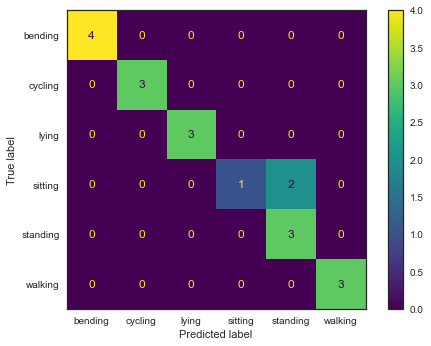

In [145]:
sns.set_style("ticks",{'axes.grid' : False})
disp = ConfusionMatrixDisplay(confusion_matrix(Y_test, y_pred, labels=mutltinomial_regressor.classes_), display_labels=mutltinomial_regressor.classes_)
disp.plot()

In [146]:
auc_report = class_report(Y_test, y_pred, mutltinomial_regressor.predict_proba(X_test))
print(auc_report)

             precision    recall  f1-score  support  pred  ROC Curve AUC
bending       1.000000  1.000000  1.000000      4.0   4.0       1.000000
cycling       1.000000  1.000000  1.000000      3.0   3.0       1.000000
lying         1.000000  1.000000  1.000000      3.0   3.0       1.000000
sitting       1.000000  0.333333  0.500000      3.0   1.0       0.958333
standing      0.600000  1.000000  0.750000      3.0   5.0       0.958333
walking       1.000000  1.000000  1.000000      3.0   3.0       1.000000
avg / total   0.936842  0.894737  0.881579     19.0  19.0       0.994460


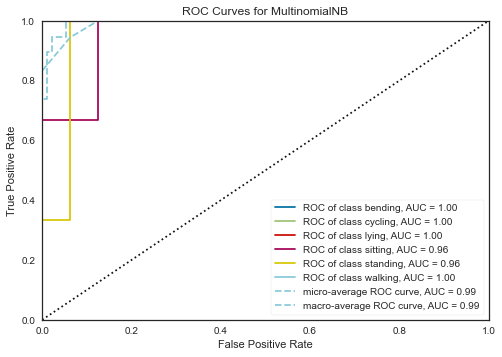

<AxesSubplot:title={'center':'ROC Curves for MultinomialNB'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [147]:
# Reference: https://afioto.medium.com/classification-visualizations-with-yellowbrick-d6f6150d7a32
visualize = ROCAUC(mutltinomial_regressor)
visualize.fit(X_train, Y_train)
visualize.score(X_test, Y_test)
visualize.show()

**(iii)**. Which method is better for multi-class classification in this problem?


### For Logistic Regressor Total AUC : 0.96  Accuracy : 0.84
### For Gaussian NB Regressor Total AUC : 0.88  Accuracy : 0.78
### For Multinomial NB Regressor Total AUC : 0.99  Accuracy : 0.89

### Considering both AUC and Accuracy, it can be said that Multinomial NB Classifier performs better on chosen data.

## 3. ISLR, 4.8.3

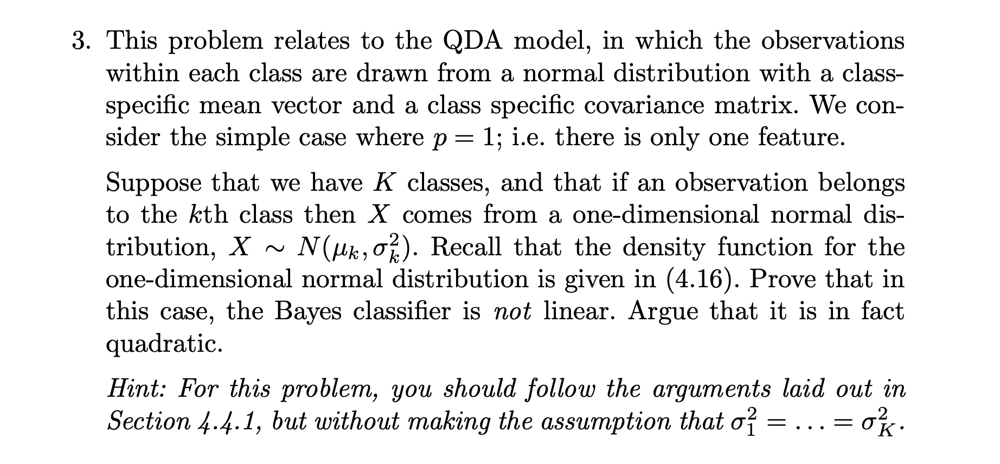

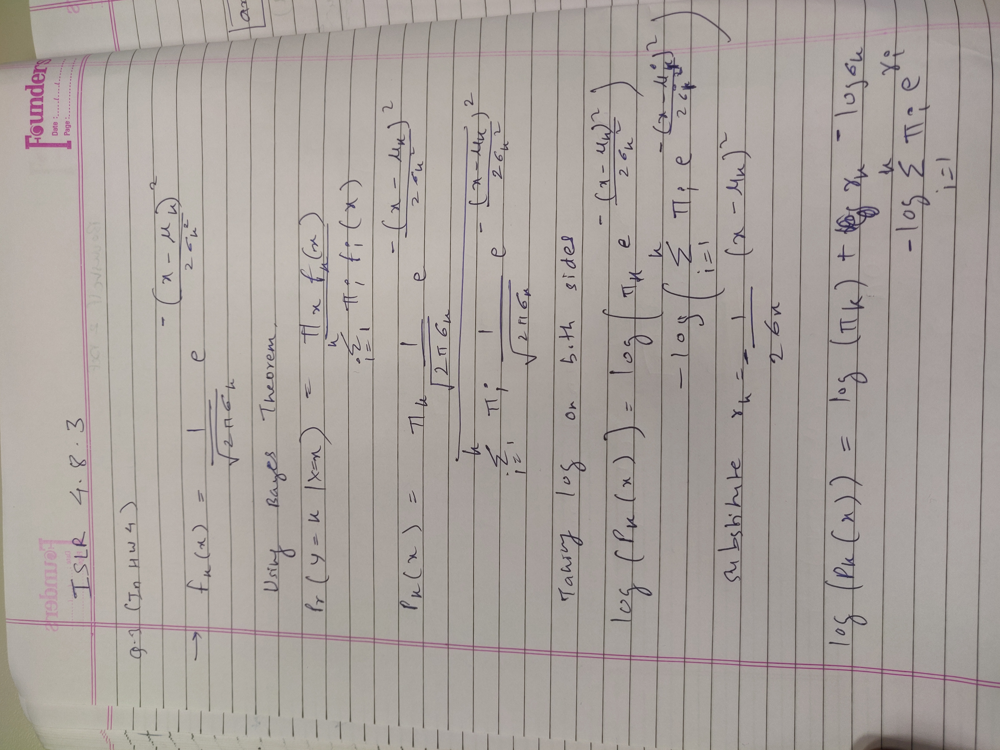

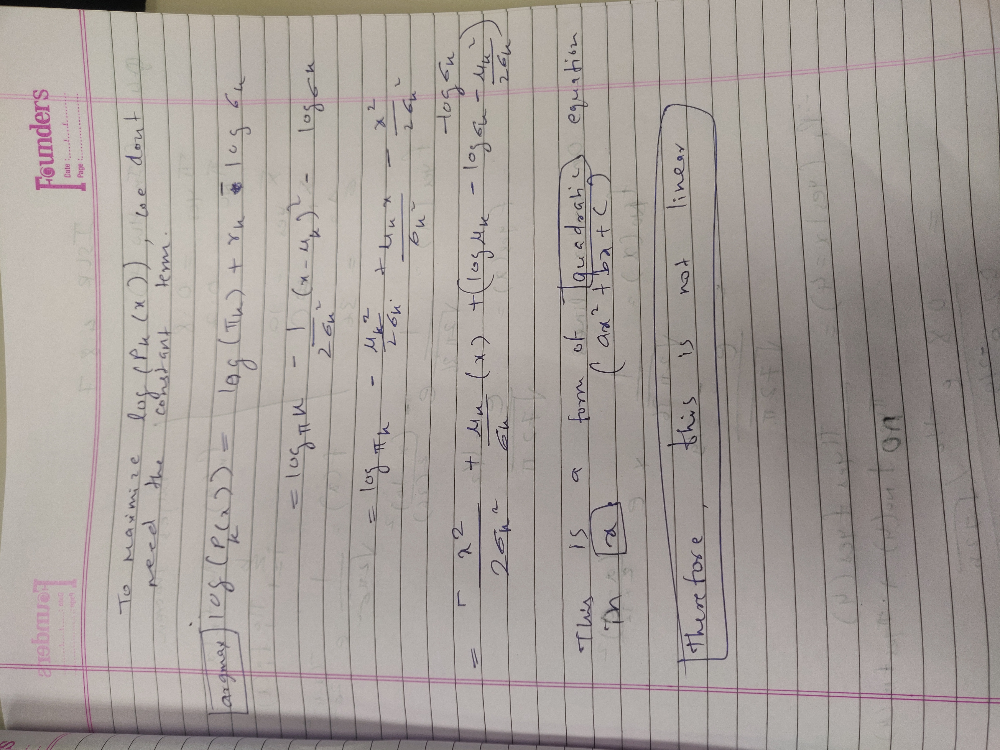

### 4. ISLR 4.8.7

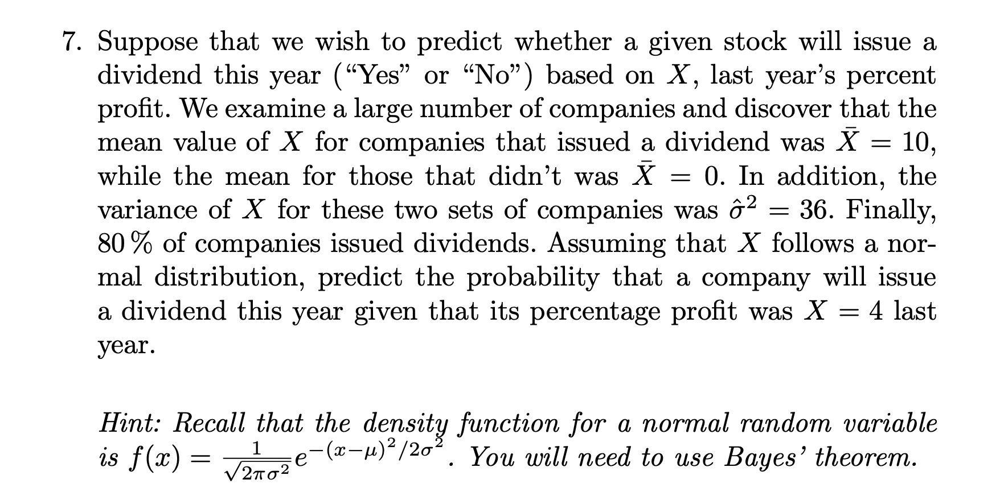

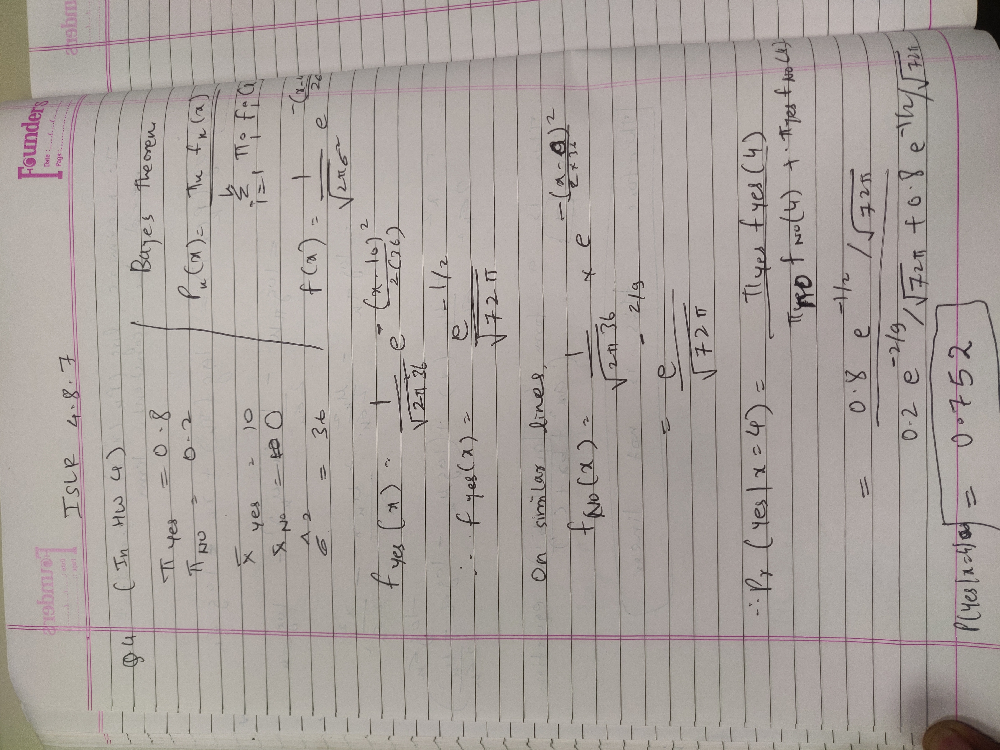